# Explaining Language Model Activations

## See the [ecco toolkit](https://ecco.readthedocs.io/en/main/){cite}`alammar-2021-ecco`

In [4]:
from explainer.explainers import lm_layers_explainer

import warnings
warnings.filterwarnings('ignore')

In [5]:
lm_layers_explainer.entry_points

EntryPoint(name='activations', value='lm_layers_explainer:activations [text,model]', group='explainer.explainers.lm_layers_explainer')
EntryPoint(name='attention_head_view', value='lm_layers_explainer:attention_head_view [model]', group='explainer.explainers.lm_layers_explainer')
EntryPoint(name='attention_model_view', value='lm_layers_explainer:attention_model_view [model]', group='explainer.explainers.lm_layers_explainer')
EntryPoint(name='attention_neuron_view', value='lm_layers_explainer:attention_neuron_view [model]', group='explainer.explainers.lm_layers_explainer')
EntryPoint(name='attributions', value='lm_layers_explainer:attributions [model]', group='explainer.explainers.lm_layers_explainer')
EntryPoint(name='predictions', value='lm_layers_explainer:predictions [text,model]', group='explainer.explainers.lm_layers_explainer')
EntryPoint(name='rankings', value='lm_layers_explainer:rankings [model]', group='explainer.explainers.lm_layers_explainer')


## Show activations in each layer in the model

In [3]:
model = 'bert-base-uncased'
text = ''' 
Now I ask you: what can be expected of man since he is a being endowed with strange qualities? 
Shower upon him every earthly blessing, drown him in a sea of happiness, so that nothing but bubbles of bliss 
can be seen on the surface; give him economic prosperity, such that he should have nothing else to do but sleep, 
eat cakes and busy himself with the continuation of his species, and even then out of sheer ingratitude, sheer spite, 
man would play you some nasty trick. He would even risk his cakes and would deliberately desire the most fatal rubbish, 
the most uneconomical absurdity, simply to introduce into all this positive good sense his fatal fantastic element. 
It is just his fantastic dreams, his vulgar folly that he will desire to retain, simply in order to prove to himself--as though that were so necessary-- 
that men still are men and not the keys of a piano, which the laws of nature threaten to control so completely that soon one will be able to desire nothing but by the calendar. 
And that is not all: even if man really were nothing but a piano-key, even if this were proved to him by natural science and mathematics, even then he would not become reasonable,
but would purposely do something perverse out of simple ingratitude, simply to gain his point. And if he does not find means he will contrive destruction and chaos, will 
contrive sufferings of all sorts, only to gain his point! He will launch a curse upon the world, and as only man can curse (it is his privilege, the primary distinction 
between him and other animals), may be by his curse alone he will attain his object--that is, convince himself that he is a man and not a piano-key!
'''
activations = lm_layers_explainer['activations'](model, text)
activations(n_components=8)

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.predictions.transform.LayerNorm.bias', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


<IPython.core.display.Javascript object>

## Fill in the blank: "Heathrow airport is located in the city of __"

In [4]:
model = 'distilgpt2'
text = " Heathrow airport is in the city of"
predictions = lm_layers_explainer['predictions'](model, text)

Downloading:   0%|          | 0.00/762 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.04M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/456k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/353M [00:00<?, ?B/s]

<IPython.core.display.Javascript object>

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


<IPython.core.display.Javascript object>

## Visualize the candidate tokens at the last layer of the model (layer 5)

In [5]:
predictions(position=8, layer=5)

<IPython.core.display.Javascript object>

## We can see more tokens using the topk parameter

In [6]:
predictions(position=8, layer=5, topk=20)

<IPython.core.display.Javascript object>

## Visualize the candidate tokens at every layer

In [7]:
predictions(position=8)

<IPython.core.display.Javascript object>

## Show rankings for the next word

<IPython.core.display.Javascript object>

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


<IPython.core.display.Javascript object>

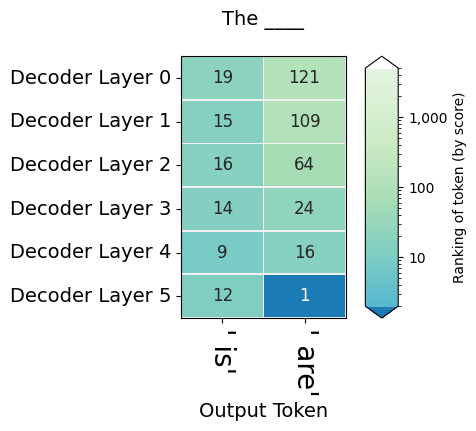

In [8]:
model = 'distilgpt2'
text = "The keys to the cabinet"
rankings = lm_layers_explainer['rankings'](model)
rankings(text, generate=1, do_sample=False).rankings_watch(watch=[318, 389], position=5)

## Attention head view

### Usage
- Hover over any token on the left/right side of the visualization to filter attention from/to that token. The colors correspond to different attention heads.
- Double-click on any of the colored tiles at the top to filter to the corresponding attention head.
- Single-click on any of the colored tiles to toggle selection of the corresponding attention head.
- Click on the Layer drop-down to change the model layer (zero-indexed).
- The lines show the attention from each token (left) to every other token (right). Darker lines indicate higher attention weights. When multiple heads are selected, the attention weights are overlaid on one another.

In [9]:
model = 'bert-base-uncased'
text = "The cat sat on the mat"
print(lm_layers_explainer['attention_head_view'].__doc__)
head_view = lm_layers_explainer['attention_head_view'](model)

head_view(text)


     visualize attention importance within one or more attention head layers
 
     Usage:
     - Hover over any token on the left/right side of the visualization to filter attention from/to that token. The colors correspond to different attention heads.
     - Double-click on any of the colored tiles at the top to filter to the corresponding attention head.
     - Single-click on any of the colored tiles to toggle selection of the corresponding attention head.
     - Click on the Layer drop-down to change the model layer (zero-indexed).
     - The lines show the attention from each token (left) to every other token (right). Darker lines indicate higher attention weights. 
     - When multiple heads are selected, the attention weights are overlaid on one another.
 
     Args:
       model (pytorch): large language model such as bert, gpt-2
       text  (str): input text that is given to the model tokenizer
 
     Returns:
       Activations: this class shows activations within the mod

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.predictions.decoder.weight', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.seq_relationship.weight', 'cls.predictions.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.dense.bias']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


<IPython.core.display.Javascript object>

In [10]:
model = 'bert-base-uncased'
sentence_a = "The cat sat on the mat"
sentence_b = "The cat lay on the rug"
neuron_view = lm_layers_explainer['attention_neuron_view'](model)
neuron_view(sentence_a, sentence_b)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 231508/231508 [00:00<00:00, 1062149.48B/s]


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [11]:
model = 'facebook/bart-large-cnn'
sentence_a = "The House Budget Committee voted Saturday to pass a $3.5 trillion spending bill"
sentence_b = "The House Budget Committee passed a spending bill."
model_view = lm_layers_explainer['attention_model_view'](model)
model_view(sentence_a, sentence_b)

Downloading:   0%|          | 0.00/1.58k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.63G [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/899k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/456k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

<IPython.core.display.Javascript object>